# Assignment 5 Group 4

Team Mambers:
            
            Athipathi Janarth
            Nishanth Prasath
            Vikash Singh
            

<b>Installing & importing all the packages</b>

pip install opencv-python

pip install fpdf

pip install pillow

pip install fpdf

In [34]:
pip install opencv-python #for processing the image

Note: you may need to restart the kernel to use updated packages.


In [35]:
pip install fpdf #converting Images to PDF

Note: you may need to restart the kernel to use updated packages.


In [36]:
pip install pillow #for adding borders

Note: you may need to restart the kernel to use updated packages.


In [37]:
p09pip install fpdf #for converting to PDF

Note: you may need to restart the kernel to use updated packages.


In [38]:
import os
import numpy as np
from PIL import Image ,ImageOps, ImageFont, ImageDraw
import pandas as pd
import cv2
from IPython.display import display

from fpdf import FPDF

In [39]:
#Change to your local path to Avoid error
path = "/Users/athipathi/Data Science Methods and Technology/Assignment5_Group4_Athipathi_Nishanth_Vikash/"

In [40]:
fullpath=path+"Images/"
dirs = os.listdir(fullpath)

#resize the images
def resize():
        for item in dirs: 
            if os.path.isfile(fullpath+item):
                if(item!='.DS_Store'):                                       
                    im = Image.open(fullpath+item)
                    f, e = os.path.splitext(fullpath+item)
                    imResize = im.resize((750,450), Image.ANTIALIAS)
                    imResize.save(f + '.jpg', quality=90)



In [41]:
resize()

In [42]:
dialogue = pd.read_csv('StalkerDialogue.csv')
dialogue.tail(5)

,English_SubText,Tamil_SubText
55,Once the police leaves; they try to go to sleep,போலீஸ் கிளம்பியதும்; அவர்கள் தங்கள் புலன்களைச்...
56,Athi sees through the window and he screams…,அவ்வாறு முயற்சிக்கும் போது; ஜன்னல் வழியே பார்த...
57,Vik and Nish come running to the room and ask ...,விக் மற்றும் நிஷ் அறைக்கு ஓடி வந்து என்ன நடந்த...
58,They see the girl standing outside the window...,ஜன்னலுக்கு வெளியே நிற்பதை அவர்கள் பார்க்கிறார்...
59,To be continued …...,தொடரும்


# Changing Images to Cartoon


In [43]:
def imgcompress_mem(path_in,k):
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # set the ratio of resized image
    width = int((img.shape[1])/2)
    height = int((img.shape[0])/2)

    # resize the image by resize() function of openCV library
    return cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

In [44]:
def cartoonizebl_mem(path_in, k, blur, line):
    
    imgc = imgcompress_mem(path_in,k)
    #imgc_pil = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    #display(Image.fromarray(imgc_pil))

    line_size = line
    blur_value = blur
    #imgc = cv2.imread(path_out, cv2.IMREAD_UNCHANGED)
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    #display(Image.fromarray(bigedges_pil))

    return cv2.bitwise_and(imgc, imgc, mask=bigedges)

In [45]:
cblimg = cartoonizebl_mem('CoverImage.jpg',2, 5, 13)
cblimg_pil = cv2.cvtColor(cblimg, cv2.COLOR_BGR2RGB)

# Adding Text for the Images

In [46]:
caption = u"பின்தொடர்பவர்"

TINT_COLOR = (0, 0, 0)  # Black
TRANSPARENCY = .25  # Degree of transparency, 0-100%
OPACITY = int(255 * TRANSPARENCY)

img = Image.open('IMG_3650.jpg').convert('RGBA')

overlay = Image.new('RGBA', img.size, TINT_COLOR+(0,))
draw = ImageDraw.Draw(overlay)
font = ImageFont.truetype("Fonts/NotoSansTamil-VariableFont_wdth,wght.ttf", 66)

#x, y = (img.width - 510, img.height-100)
text = caption
w, h = font.getsize(text)
num_lines = len(text.split('\n'))
print(num_lines, w, h)
x, y = 100, img.height - (num_lines-0.1*num_lines)*h
#draw.rectangle((x, y, x + w, y + h), fill='black')
#draw.rectangle((x, y, x + w, y + 4*h), fill=TINT_COLOR+(OPACITY,))
draw.rectangle((x, y, x + img.width - 200, y + (num_lines-0.1*num_lines)*h), fill=TINT_COLOR+(OPACITY,))
draw.text((x, y), text, fill=(209, 239, 8), font=font)


# Alpha composite these two images together to obtain the desired result.
img = Image.alpha_composite(img, overlay)
img = img.convert("RGB") # Remove alpha for saving in jpg format.


1 566 80


In [47]:

TINT_COLOR = (0, 0, 0)  # Black
OPACITY = int(255 * 0.75)
FONT = ImageFont.truetype("Fonts/Roboto-Regular.ttf", 24) # Font
IMG_BASE_WIDTH = 600
IMG_NUMBERS = 47

def convert_from_cv2_to_image(img: np.ndarray) -> Image:
    return Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #return Image.fromarray(img)

def convert_from_image_to_cv2(img: Image) -> np.ndarray:
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    #return np.asarray(img)


In [48]:
# Controls blur amount and line size and number of text lines. No bold font!
def cartoonizeblt_mem_nb(path_in, k, blur, line, text, nlines=1, font='English'):
    
    imgc = imgcompress_mem(path_in, k)

    line_size = line
    blur_value = blur
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    toon = cv2.bitwise_and(imgc, imgc, mask=bigedges)
    if 0 == len(text):
        return toon
    
    myfont = (
        ImageFont.truetype("Fonts/Roboto-Regular.ttf", 
            24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='English'
        else
            ImageFont.truetype("Fonts/NotoSansTamil-VariableFont_wdth,wght.ttf", 
                24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='Tamil'
        else
            ImageFont.truetype(font + ".ttf", 24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82)
    )


    cblimg_pil = Image.fromarray(cv2.cvtColor(toon, cv2.COLOR_BGR2RGBA))

    overlay = Image.new('RGBA', cblimg_pil.size, TINT_COLOR+(1,))
    draw = ImageDraw.Draw(overlay)
    #_, h = FONT.getsize(text)
    _, h = myfont.getsize(text)
    num_lines = nlines
    n=50
    if(font=='Tamil'):
        n=30
    #Checking the text length and deciding the number of lines
    if(len(text)>(n*2)):
        num_lines =3
        chunks = [text[i:i+n] for i in range(0, len(text), n)]
    elif(len(text)>n):
        num_lines =2
        chunks = [text[i:i+n] for i in range(0, len(text), n)]
        
    if(num_lines==1):
        x, y = 0, cblimg_pil.height - (num_lines)*h-10
        draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+10), fill=TINT_COLOR+(OPACITY,))
        if k == 1:
            draw.text((x+10, y), text, fill=(248,248,248), font=myfont) #, stroke_width=1)
        elif k < 8:
            draw.text((x+10, y), text, fill=(248,248,248), font=myfont)
        else:
            draw.text((x+10, y), text, fill=(248,248,248), font=myfont) #, stroke_width=1)
   
    #iterating and printing each line
    else:
        x, y = 0, cblimg_pil.height - (num_lines)*h-10
        draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+10), fill=TINT_COLOR+(OPACITY,))
        for i in range(0,len(chunks)):      
            if k == 1:
                draw.text((x+10, y), chunks[i], fill=(248,248,248), font=myfont) #, stroke_width=1)
            elif k < 8:
                draw.text((x+10, y), chunks[i], fill=(248,248,248), font=myfont)
            else:
                draw.text((x+10, y), chunks[i], fill=(248,248,248), font=myfont) #, stroke_width=1)
            y=y+15

    cblimg_pil = Image.alpha_composite(cblimg_pil, overlay)
    cblimg_pil = cblimg_pil.convert("RGB")
    
    return convert_from_image_to_cv2(cblimg_pil)


# Cover Image for Book

In [49]:
def coverImage(file_path):
    img = cv2.imread(file_path, cv2.IMREAD_UNCHANGED)
    img_pil = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, 33)
    gray_blur_pil = cv2.cvtColor(gray_blur, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    result=Image.fromarray(gray_blur_pil)
    result.save('BookTitle.jpg')
    

In [50]:
coverImage('CoverImage.jpg')

# Adding Borders to Image

In [51]:
#Adding Borders
def borderImages(output_path):
    for filename in (dirs):
        if ('jpg') in filename.lower():
            ImageOps.expand(Image.open(fullpath+filename), border=(10,10),fill='white').save(output_path+filename)
            ImageOps.expand(Image.open(output_path+filename), border=(10,10),fill='black').save(output_path+filename)


In [52]:
borderedImgPath =  path+"BorderedImage/"
englishPath = path+"English/"
tamilPath = path+"Tamil/"

In [53]:
borderImages(borderedImgPath)

# Creating Rows

In [54]:
def simple_row(folder, list_im, list_txt, list_nlines, font='English'):
    
    # cartoonize them in memory with text
    cimgs = [ cartoonizeblt_mem_nb(folder + '/' + i + '.jpg', 14, 1, 3, j, nlines=k, font=font)
              for i,j,k in zip(list_im, list_txt, list_nlines) ]
    
    # resize
    heighto = int(cimgs[0].shape[0])
    widtho = int(cimgs[0].shape[1])
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 333
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [ cv2.resize(cimgs[i], cimgs_dim, interpolation = cv2.INTER_AREA) for i in range(3)]

    # add borders
    white = [255,255,255]
    bcimgs = [ cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr ]

    # stack them horizontally
    return np.concatenate([ bcimgs[i] for i in range(0,len(list_im)) ], axis=1)

In [55]:
cblimg =cartoonizeblt_mem_nb('IMG_3650.jpg',14, 1, 3, 'They saw her drowing...', 1,'English')

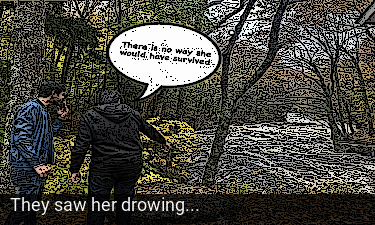

In [56]:
cblimg_pil = cv2.cvtColor(cblimg, cv2.COLOR_BGR2RGB)
display(Image.fromarray(cblimg_pil))

In [57]:
englishDialouge=dialogue['English_SubText']
tamilDialouge=dialogue['Tamil_SubText']

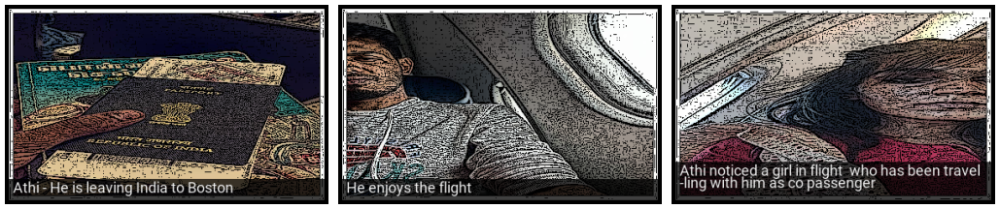

(216, 1029, 3)

In [58]:
rows3 = simple_row (
        path+'BorderedImage/', 
         ['1', '2', '3'],
         [englishDialouge[0], englishDialouge[1], englishDialouge[2]],
         [1, 1, 1],
        font='English'
        )
rows3_pil = cv2.cvtColor(rows3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows3_pil))
rows3_pil.shape

In [59]:
borderedImages=[]
englishDir = os.listdir(borderedImgPath)
for item in englishDir:
    if os.path.isfile(borderedImgPath+item):
        if(item!='.DS_Store'): 
            if('.jpg' in item and 'row' not in item):
                a=item.replace(".jpg","")
            elif('.JPG' in item and 'row' not in item):
                a=item.replace(".JPG","")
            borderedImages.append(a)

In [60]:
borderedImages.sort(key = int)

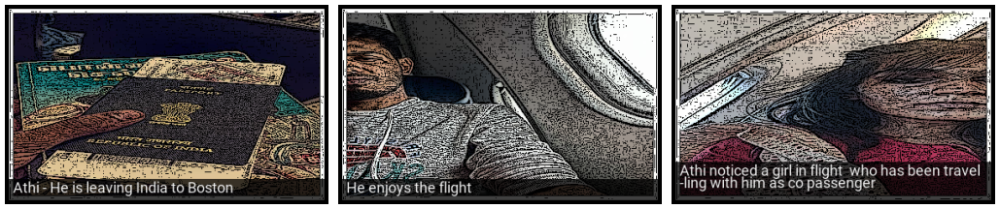

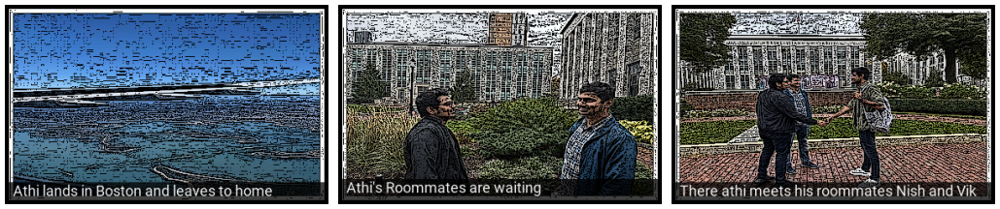

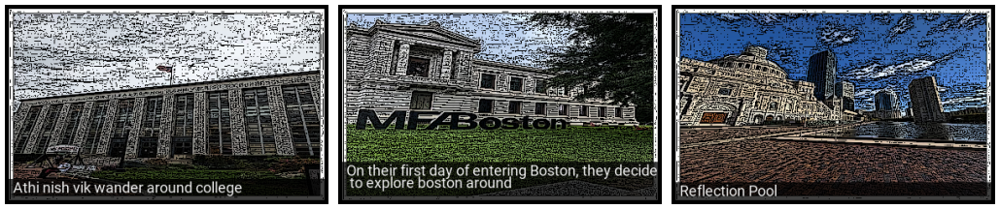

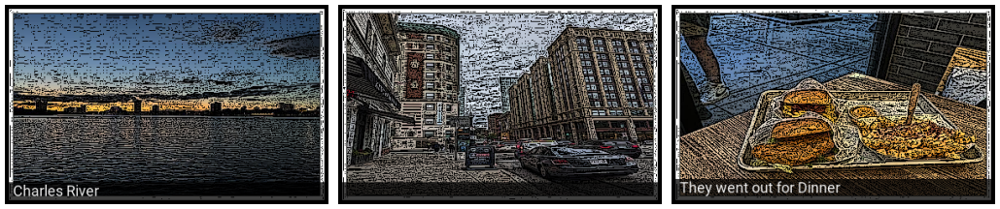

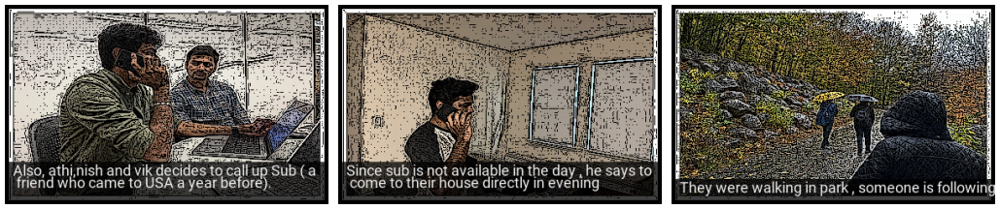

...

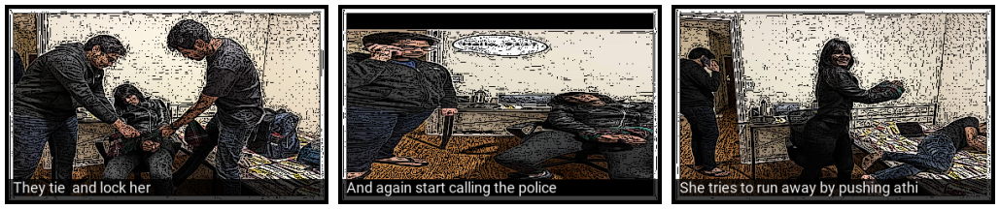

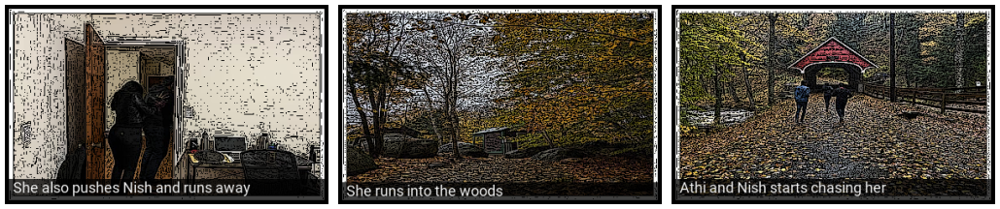

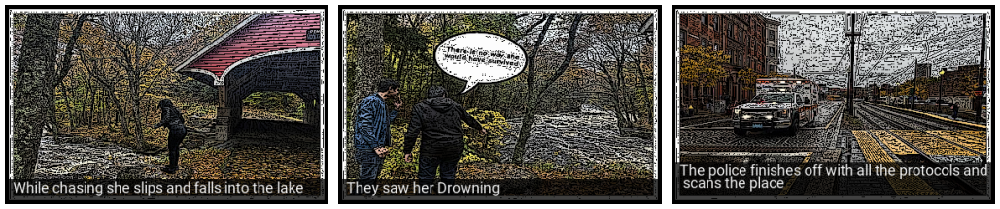

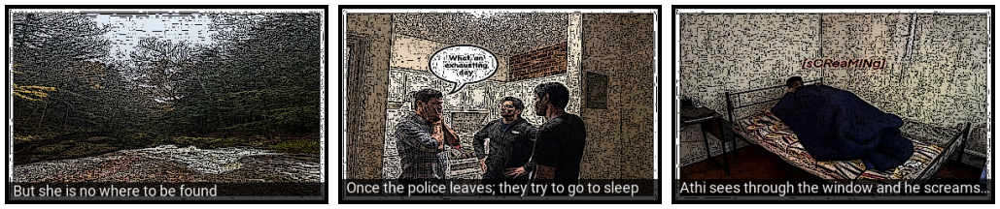

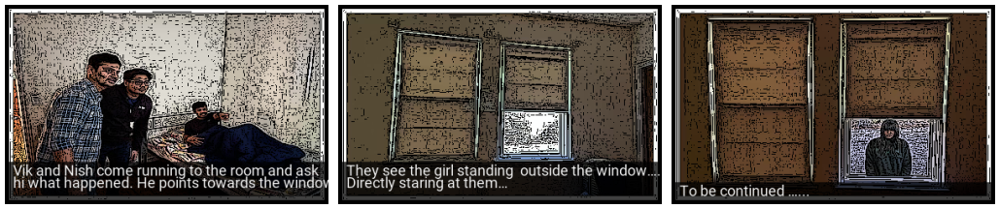

In [61]:
list_Images = np.array_split(borderedImages,20)
list_englishDialogue = np.array_split(englishDialouge,20)
count=0
for i,j in zip(list_Images,list_englishDialogue):
    rows3 = simple_row (
    borderedImgPath, 
     i,
     j,
     [1, 1, 1],
    font='English'
    )
    rows3_pil = cv2.cvtColor(rows3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    imgs_comb = Image.fromarray(rows3_pil)
    imgs_comb.save( englishPath+str(count)+'.jpg')
    display(Image.fromarray(rows3_pil))
    rows3_pil.shape
    count=count+1


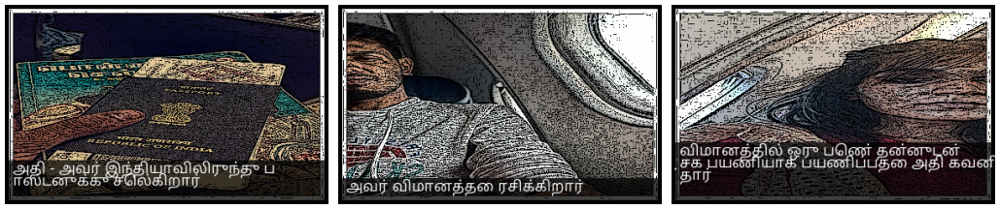

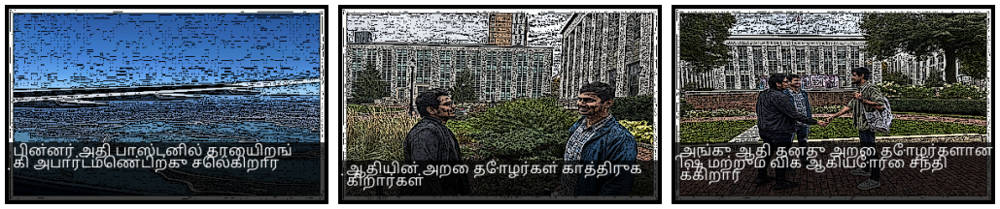

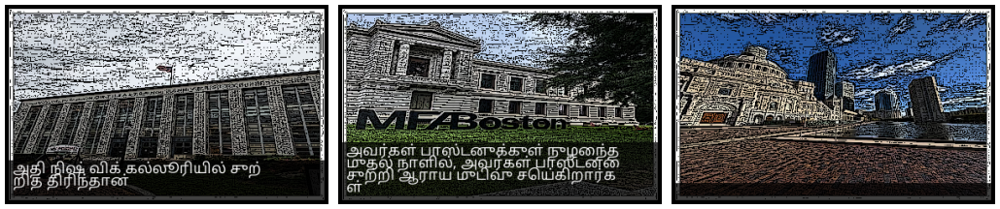

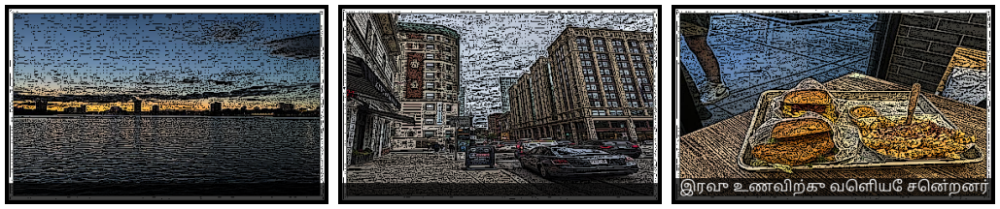

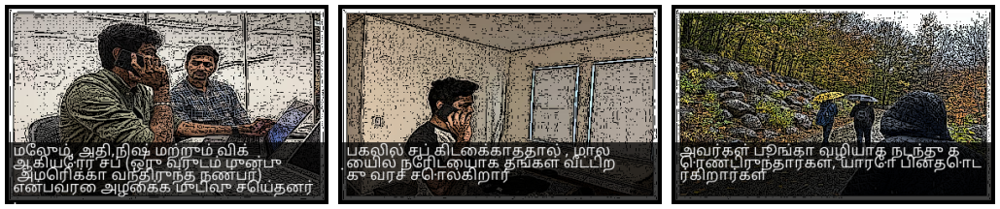

...

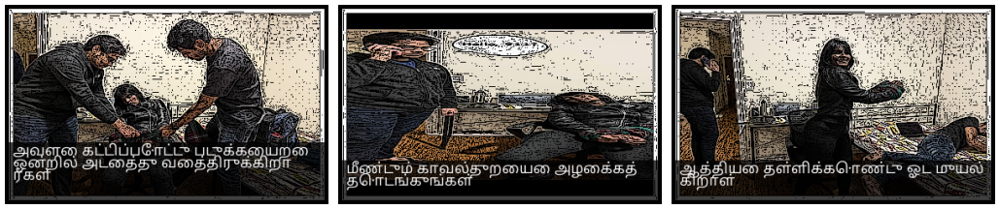

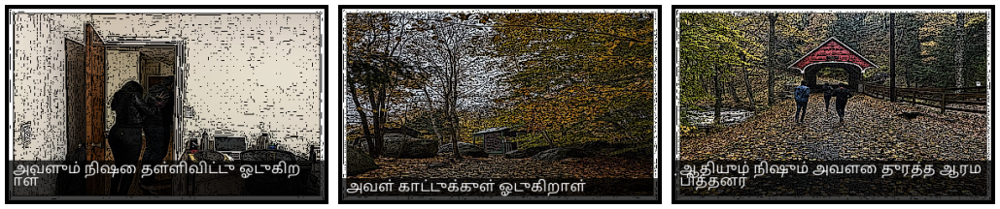

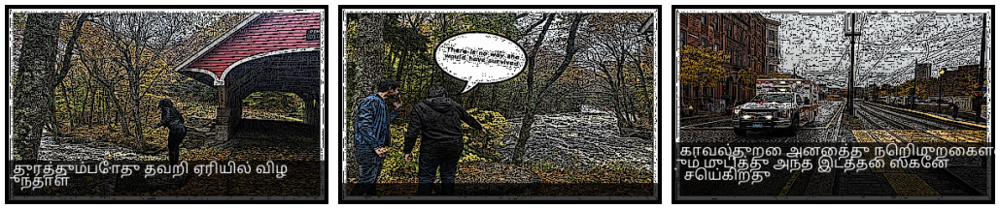

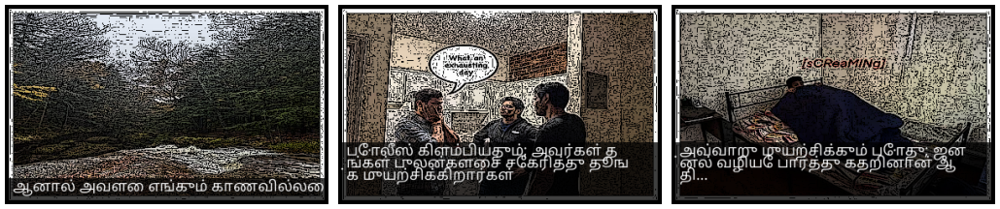

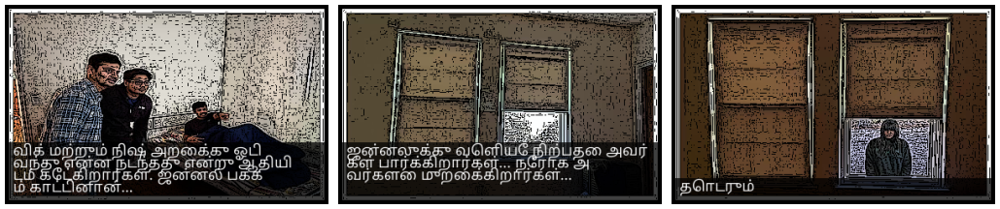

In [62]:
list_tamilDialogue = np.array_split(tamilDialouge,20)
count=0
for i,j in zip(list_Images,list_tamilDialogue):
    rows3 = simple_row (
    borderedImgPath, 
     i,
     j,
     [1, 1, 1],
    font='Tamil'
    )
    rows3_pil = cv2.cvtColor(rows3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    imgs_comb = Image.fromarray(rows3_pil)
    imgs_comb.save( tamilPath+str(count)+'.jpg')
    display(Image.fromarray(rows3_pil))
    rows3_pil.shape
    count=count+1

In [63]:
englishRowImages=[]
englishDir = os.listdir(englishPath)
for item in englishDir:
    if os.path.isfile(englishPath+item):
        if(item!='.DS_Store'): 
            if('.jpg' in item and 'row' not in item):
                a=item.replace(".jpg","")
                englishRowImages.append(a)
                
tamilRowImages=[]
tamilDir = os.listdir(tamilPath)
for item in englishDir:
    if os.path.isfile(tamilPath+item):
        if(item!='.DS_Store'): 
            if('.jpg' in item and 'row' not in item):
                a=item.replace(".jpg","")
                tamilRowImages.append(a)

In [64]:
englishRowImages.sort(key = int)
tamilRowImages.sort(key = int)

In [65]:
cover = Image.open('BookTitle.jpg')
width, height = cover.size
pdf = FPDF(unit = "pt", format = [width, height])
pdf.add_page()
pdf.image('BookTitle.jpg', 0, 0, width, height)
file=0

imgs_set_english = np.array_split(englishRowImages, 4)

for image in imgs_set_english:    
    imgs    = [Image.open(englishPath+str(i)+'.jpg') for i in image ]
    min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
    imgs_comb = np.vstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )
    
    # save that beautiful picture
    imgs_comb = Image.fromarray(imgs_comb)
    imgs_comb.save( englishPath+'row'+str(file)+'.jpg') 

    cover = Image.open(englishPath+'row'+str(file)+'.jpg')

    width, height = cover.size
    
    pdf.add_page()
    pdf.image( englishPath+'row'+str(file)+'.jpg', 0, 0, width*1.1025, height*1.3777)
    file=file+1
pdf.output("Stalker_Part1_English.pdf", "F")

print("English PDF generated Succesfully!")

English PDF generated Succesfully!


/var/folders/vv/q4cvdpxd5vb5y_ngs0c23mfw0000gn/T/ipykernel_1047/1459932185.py:13: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )


In [66]:
cover = Image.open('BookTitle.jpg')
width, height = cover.size
pdf = FPDF(unit = "pt", format = [width, height])
pdf.add_page()
pdf.image('BookTitle.jpg', 0, 0, width, height)
file=0

imgs_set_tamil = np.array_split(tamilRowImages, 4)

for image in imgs_set_tamil:    
    imgs    = [Image.open(tamilPath+str(i)+'.jpg') for i in image ]
    min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
    imgs_comb = np.vstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )
    
    # save that beautiful picture
    imgs_comb = Image.fromarray(imgs_comb)
    imgs_comb.save( tamilPath+'row'+str(file)+'.jpg') 

    cover = Image.open(tamilPath+'row'+str(file)+'.jpg')

    width, height = cover.size
    
    pdf.add_page()
    pdf.image( tamilPath+'row'+str(file)+'.jpg', 0, 0, width*1.1025, height*1.3777)
    file=file+1
pdf.output("Stalker_Part1_Tamil.pdf", "F")

print("Tamil PDF generated Succesfully!")

/var/folders/vv/q4cvdpxd5vb5y_ngs0c23mfw0000gn/T/ipykernel_1047/1640192432.py:13: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( i.resize(min_shape) ) for i in imgs ) )


Tamil PDF generated Succesfully!
